<a href="https://colab.research.google.com/github/harshwalia36/Audio-Description-of-Image-for-visually-impaired-person/blob/master/Lec65_Object_Localization_and_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Object Localization and Detection

* Till now You have seen the **power of CNN** in `Classification of image`.
* But there is the more **Real World Usage of CNN**.
* What if we have to **Locate something** in an image?
* You have seen how **Self-driving cars** locate **different objects in an image** like Road, Bicycle, car etc.
* CNN can also help us in `Locating the object in an image`.
* Let’s see how we can locate an object in an image.


**Business Use case:** `You are working as a Data Scientist at ISRO.`

 `ISRO has just launched a new branch for aerial surveillance. They want to detect drones in any open sky images. `

**TASK: Detect the number of instances of objects as well as what type of object is present in the aerial frame.**


Let's Load the data for this task.

Dataset folder: https://drive.google.com/drive/folders/1Z4YyQxrpPjQkyyYFHgxLq-QGTzh2qt_p?usp=sharing

In [ ]:
# Import Drive
from google.colab import drive
drive.mount('/content/gdrive/',force_remount=True)

Mounted at /content/gdrive/


In [ ]:
path= '/content/gdrive/My Drive/DSML_Course_Curriculum/Lec-Object_Localization_and_detection/drone_object_detection/Dataset/'
path2 = '/content/gdrive/My Drive/DSML_Course_Curriculum/Lec-Object_Localization_and_detection/drone_object_detection/tensorflow'

In [ ]:
import pandas as pd
import numpy as np
import os 
from PIL import Image
import cv2
import matplotlib.pyplot as plt
from lxml import etree
import pathlib

import tensorflow as tf
import xml.etree.ElementTree as ET 

from sklearn.model_selection import train_test_split

Let's load the data

In [ ]:
def load_data():
  Y = np.load(path+'Y_final.npy',allow_pickle=True)  
  X = np.load(path +'X_final.npy')
  return X,Y

In [ ]:
X,Y = load_data()
print(X.shape,Y.shape)

(1459, 256, 256, 3) (1459, 5)


In [ ]:
# Output label
Y[0]

array([0.      , 0.501538, 0.458445, 0.646154, 0.552279])

**INFERENCE FROM DATASET**
* Output is in format `class_label`, `x_center`, `y_center`, `width`,`height`.
* Co-ordinate are **on (0-1) scale**.
* Bounding Box is given in **Yolo Format**.
* See Below what is **YOLO Format** exactly.

**What are Different Annotation formats for object detection?**

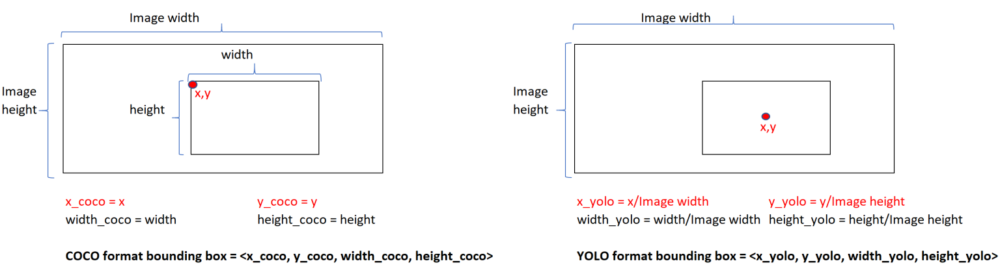

* **COCO JSON**: 
  *  At a very high level, the bounding box in COCO format is **<top left x, top left y, width, height>**, where width and height are the dimensions of the bounding box. 
  * Also, the category IDs of various classes in the** COCO format starts from 1 to num_of_categories**.

* **.txt for YOLO**: 
  * It basically uses **.txt file** to define bounding boxes for objects in each image.
  * Additionally, there is **object.names** file that contains a list of all the categories. 
  * The bounding box in YOLO format is **<relative x position of the center of the box, relative y position of the center of the box , relative width of the box, relative height of the box>**.
  *  The **categories ID for various classes** in the YOLO format starts from **0 to num_of_categories -1**.

**You have seen how CNN can classify an image into different classes.**

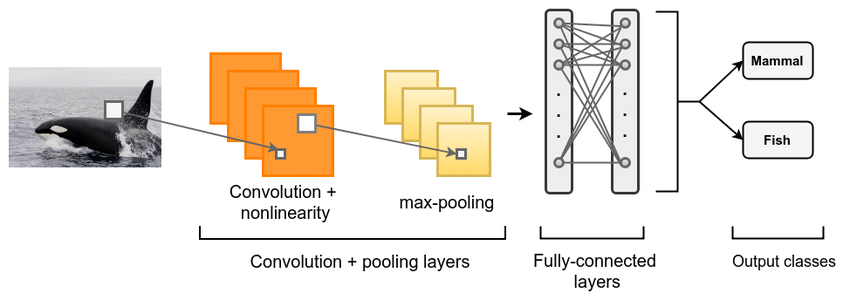

## What if we want to locate where the object is present in an image?

* To identify `where the Object is Present in an image` and `Drawing Bounding Box` along that Object is called **Object Localization**.
* In **Object Localization** we locate **only single object present in an image.**

**How can we Localize an object in an image?**

* We can locate the object in an image **by drawing Bounding Box along that Object**.


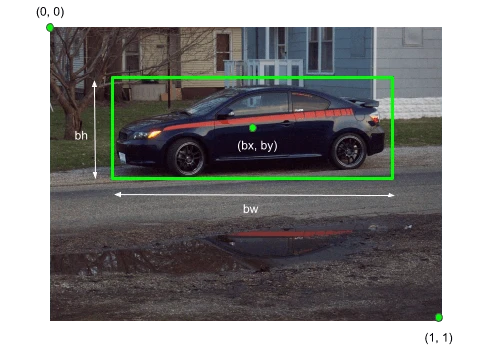

A bounding box can be initialized using the following parameters:

* **bx, by** : coordinates of the center of the bounding box
* **bw** : width of the bounding box w.r.t the image width
* **bh** : height of the bounding box w.r.t the image height

#### Can CNN can also be used to output Bounding Box?

* **Recall**, how we do Classification through CNN
* ConvNet's learn **features of image** and finally passes through a **softmax layer** to return the class of image.
* To **localize the object** in the image we want **4 outputs which represent the Bounding Box Co-ordinates.**
* We can do this by treating as a **Regression Problem**.
* Remove the `classification head` of CNN and put a `regression head` which will output the **Center of Bounding Box(x,y)** and **Width** and **height** of B.B.

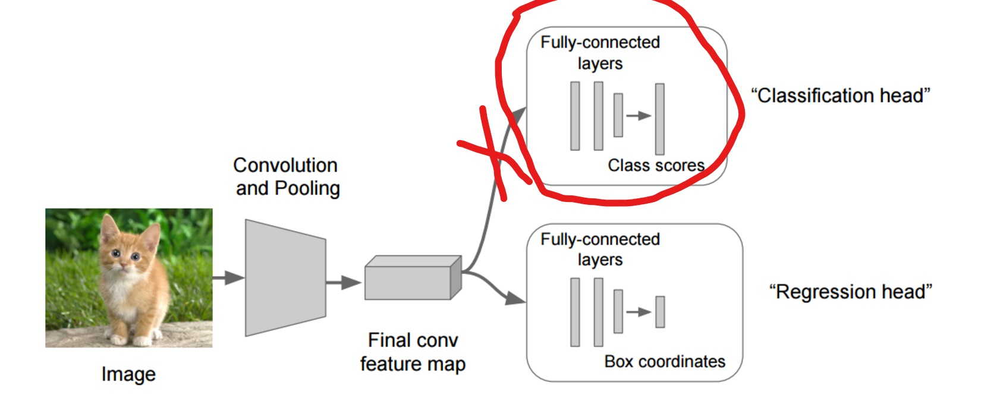

In above image we have **Removed Classification head** and **added Regression head** to CNN which **outputs (bx,by,bw,bh) Bounding Box Co-ordinates**.

### How do Object Localization Works?

* In an **image localization** algorithm, everything is the same as **classification** except the **output layer**.
* In **classification algorithms**, the final layer gives a `probability value`  **ranging from 0 to 1**. 
* In contrast, **localization algorithms** give an output in four real numbers, as **localization is a regression problem**.

### Then, What is the Loss Function in Object Localization?

* Aim of any machine learning algorithm is to **predict as close as ground truth values**.
* To do so any **supervised machine learning algorithm uses loss function** and algorithms learn by minimizing loss using weight or parameters optimization.

* **Object localization** being a regression problem, **any regression loss function applicable** to an N-dimensional array can be used.
* For eg, **L1 distance** loss, **L2 distance,** and so on.
*  From the above, **L2 distance loss is used widely used**.


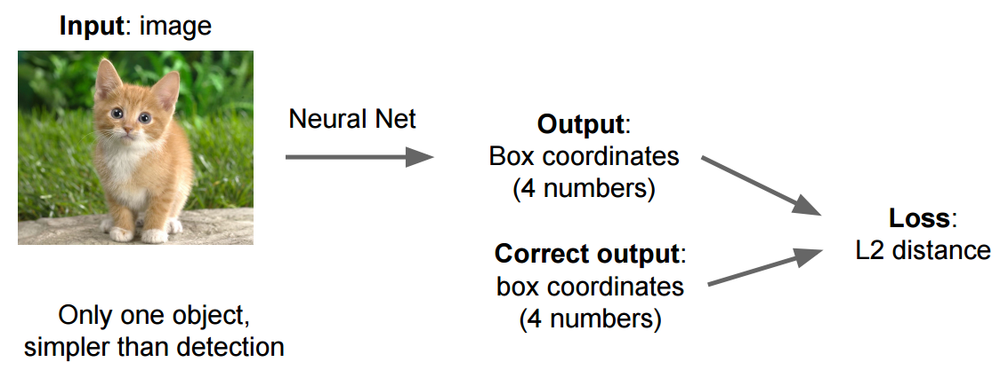

#### L2 distance

* **L2 distance** is also known as **Euclidean distance**. 
* It is a **distance** between two points in **N-dimensional space**.
* It is **calculated** by applying the **Pythagorean theorem** on the cartesian coordinates of points. 

<img src="https://hlab.stanford.edu/brian/making7.gif" width="400px" height="400px">



Now, Let's do Object Localization on our Drone Dataset.

In [ ]:
def yolo_bbox_2_bbox(box):
  '''
  This function will convert B.B cordinates from YOLO format(X_center,Y_center,width,height) ----> (x_start,y_start,x_end,y_end)
  '''
  x,y,w,h= box[0],box[1],box[2],box[3]
  x1, y1 = int((x-w/2)*img_w), int((y-h/2)*img_h)
  x2, y2 = int((x+w/2)*img_w), int((y+h/2)*img_h)
  return x1, y1, x2, y2

Let's plot some Visualization of images

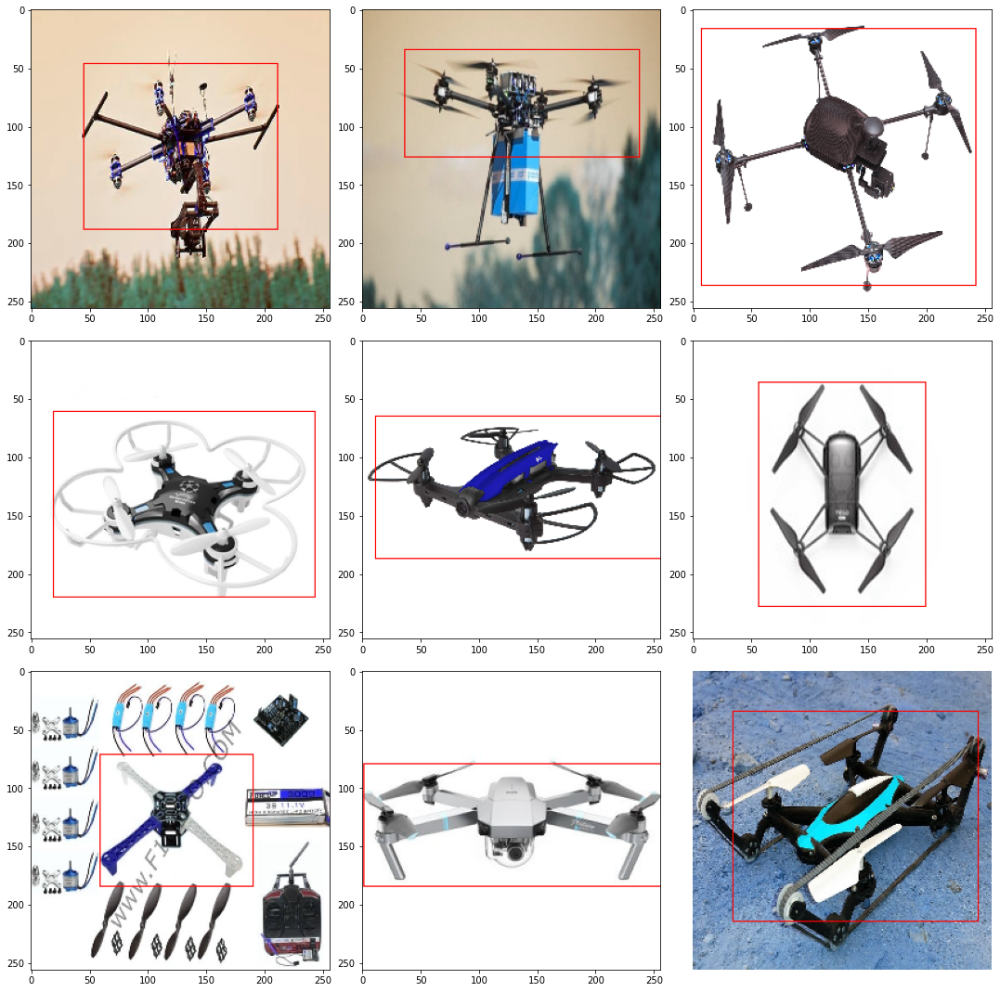

In [ ]:
fig,ax = plt.subplots(3,3,figsize=(15,15))
img_h=256
img_w=256
axis1,axis2 = 0,0
for samples in range(9):
  temp_img = X[samples].copy()

  # converting B.B cordinates from YOLO format(X_center,Y_center,width, height)  ----> (x_start,y_start,x_end,y_end)
  box=Y[samples]
  x1,y1,x2,y2=yolo_bbox_2_bbox(box[1:])   # first pos is label in box array
  start_point = (x1,y1)
  end_point =(x2,y2)
  # Draw B.B
  image = cv2.rectangle(temp_img,start_point,end_point,(255,0,0))
    
  ax[axis1,axis2].imshow(image)
  axis2+=1
  plt.axis('off')
  if axis2==3:
    axis1 += 1
    axis2 = 0

plt.axis('off')
plt.tight_layout()
plt.show()

* We have plotted the **Visualization of Dataset** with **Ground truth B.B**.

### Single Object Bounding Box - Regression

##### Train test split

In [ ]:
def SingleObject_data(X,Y):
    output = []
    for y in Y:
      output.append(y[1:])         # take only first B.B out of multiple B.B
    
    return X,np.array(output)

In [ ]:
X_single,y_single = SingleObject_data(X,Y)

In [ ]:
X_single.shape,y_single.shape

((1459, 256, 256, 3), (1459, 4))

In [ ]:
# np.save(path+'X_final.npy',X_single)
# np.save(path+'Y_final.npy',y_single)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_single,y_single, test_size=0.33, random_state=42)

In [ ]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((977, 256, 256, 3), (482, 256, 256, 3), (977, 4), (482, 4))

# Object Localization Model

* We have seen how **adding a Regression head** at the **End of CNN** will give us Bounding Box Co-ordinates for **Object Localization**.
* Recall, how using **Transfer learning for Image classification** `boost up the performance of CNN`.
* Similarly for Localization we will Use Transfer Learning with ResNET101 model.


In [ ]:
ResNet101 = tf.keras.applications.ResNet101(weights='imagenet',include_top=False,
                            input_tensor=tf.keras.layers.Input(shape=(256,256,3)))

ResNet101.trainable = False             # make trainable parameter as false

# add some trainable Dense layers
x1 = ResNet101.output
x1 = tf.keras.layers.Flatten()(x1)
x1 = tf.keras.layers.Dense(128,activation='relu')(x1)
x1 = tf.keras.layers.Dense(64,activation='relu')(x1)
x1 = tf.keras.layers.Dense(32,activation='relu')(x1)
# Notice how we have added Regression head with 4 output.
x1 = tf.keras.layers.Dense(4,activation='sigmoid')(x1)     


ResNet101 = tf.keras.models.Model(ResNet101.input,x1)

**NOTE:** We have added **activation as Sigmoid** in last layer beacuse we want our **Co-ordinate to be output in Scale of (0-1)** and Sigmoid is the suitable activation for this task.

We have Compile and train the model for you to save the time.

In [ ]:
# ResNet101.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),metrics=
#               loss = 'mse')

# log_dir_OL = "/content/gdrive/MyDrive/drone_object_detection/logs_files/Object_Loc" 
# !rm -rf log_dir_OL

# tensorboard_callback_OL = tf.keras.callbacks.TensorBoard(log_dir=log_dir_OL)

# history = ResNet101.fit(X_train,y_train, epochs=10, validation_data=[X_test,y_test],callbacks=(tensorboard_callback_OL))

In [ ]:
# save the model
# ResNet101.save("/content/gdrive/MyDrive/DSML_Course_Curriculum/Lec-Object_Localization_and_detection/drone_object_detection/ResNet101_bb")

Let's log the Loss and accuracy curves on Tensorboard which is saved.

In [ ]:
log_folder = '/content/gdrive/MyDrive/DSML_Course_Curriculum/Lec-Object_Localization_and_detection/drone_object_detection/logs_files/Object_Loc'
%reload_ext  tensorboard
%tensorboard --logdir={log_folder}

<IPython.core.display.Javascript object>

Let's load the saved model.

In [ ]:
ResNet101=tf.keras.models.load_model("/content/gdrive/MyDrive/DSML_Course_Curriculum/Lec-Object_Localization_and_detection/drone_object_detection/ResNet101_bb")

Now, we have trained our **Object Localization** Model.

### What is the Evaluation Metric in Object Localization?

* Building a **ML models for the real world**, are required to be **evaluated  to check their performance**.
* For the **Image localization task**, **IoU is the widely used evaluation metrics**.
* IoU stands for **Intersection over Union**.

#### IoU

* It is a number from **0 to 1** that specifies the** amount of overlap between the predicted and ground truth bounding box**.
* an **IoU of 0** means that there is **no overlap between the boxes**.
* an **IoU of 1** means that the **union of the boxes is the same as their overlap** indicating that they are **completely overlapping**.

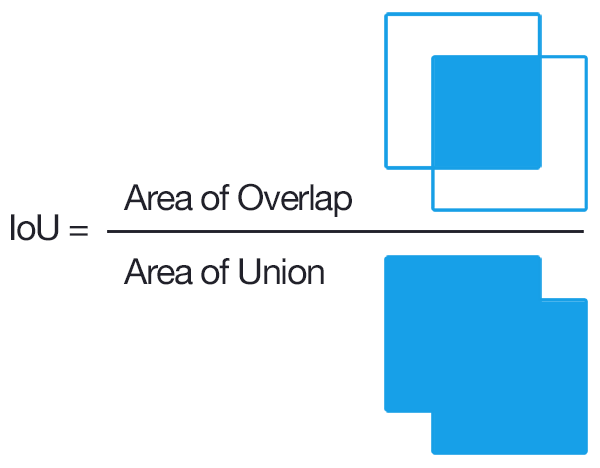

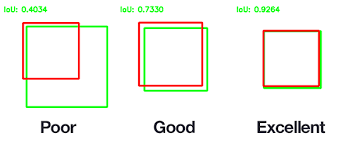

* An example showing **greater is the IoU greater is the overlap between Predicted & Ground truth bounding box and better is our model.**


### Mean IOU

Mean Iou is the metrics which take mean of all IoU's on all Predicting Bounding box for test dataset.

**Calculation of Iou**

<img src="https://www.researchgate.net/publication/335876570/figure/fig2/AS:804291526795265@1568769451765/Intersection-over-Union-IOU-calculation-diagram.png" wisth=500 height=500>

In [ ]:
def mean_intersection_over_union(gt_box,pred_box):
    iou = []
    for ind in range(len(X_test)):
      gt = gt_box[ind].copy()
      x1,y1,x2,y2=yolo_bbox_2_bbox(gt)  

      gt[0],gt[1],gt[2],gt[3] = x1,y1,x2,y2
      
      pred = pred_box[ind].copy()
      x1,y1,x2,y2=yolo_bbox_2_bbox(pred)

      pred[0],pred[1],pred[2],pred[3] = x1,y1,x2,y2

      inter_box_top_left = [max(gt[0], pred[0]), max(gt[1], pred[1])]
      inter_box_bottom_right = [min(gt[0]+gt[2], pred[0]+pred[2]), min(gt[1]+gt[3], pred[1]+pred[3])]

      inter_box_w = inter_box_bottom_right[0] - inter_box_top_left[0]
      inter_box_h = inter_box_bottom_right[1] - inter_box_top_left[1]

      intersection = inter_box_w * inter_box_h
      union = gt[2] * gt[3] + pred[2] * pred[3] - intersection
      iou.append(intersection / (union+10e-3))
    iou = np.array(iou)
    return np.mean(iou)

In [ ]:
def plotter(gt_bb,images,pred_bb,conf,class_type):
  '''
  This function plot the B.B of Ground truth and B.B Predicted by the model.
  Last 2 Parameters are needed in Object loc + classification only
  '''
  for samples in range(len(gt_bb)):
    objects = gt_bb[samples].copy()
    x1,y1,x2,y2=yolo_bbox_2_bbox(objects)
    start_point = (x1,y1)
    end_point =(x2,y2)
    
    print(start_point,end_point)

    image = images[samples].copy()
    image = cv2.rectangle(image,start_point,end_point,(255,0,0),thickness=2)  # Red color for Ground truth
    
    objects = pred_bb[samples].copy()
    x1,y1,x2,y2=yolo_bbox_2_bbox(objects)
    start_point = (x1,y1)
    end_point =(x2,y2)
    
    print(start_point,end_point)
    
    image = cv2.rectangle(image,start_point,end_point,(0,255,0),thickness=2)    # Green color for Prediction
    if class_type=="classification":
      prob=conf[samples][1]
      text= "Drone: {:.2f}%".format(prob * 100)
      cv2.putText(image, text, start_point, cv2.FONT_HERSHEY_SIMPLEX, 0.45, (0, 0, 255), 1)
    plt.figure(figsize=(5,5))
    plt.imshow(image)
    plt.show()

In [ ]:
miou = mean_intersection_over_union(y_test,ResNet101.predict(X_test))
print('Mean Intersection Over Union for ResNet101:',miou)

Mean Intersection Over Union for ResNet101: 0.5569516181617727


(2, 39) (197, 176)
(13, 46) (216, 181)


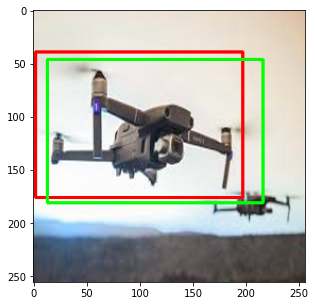

(80, 33) (256, 242)
(77, 54) (197, 209)


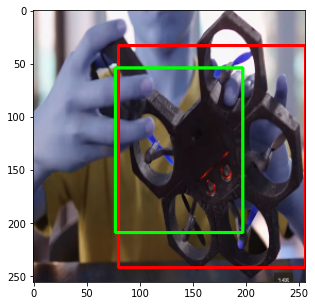

(36, 65) (218, 140)
(50, 63) (219, 169)


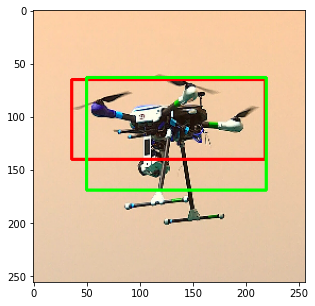

(6, 45) (255, 218)
(4, 33) (244, 221)


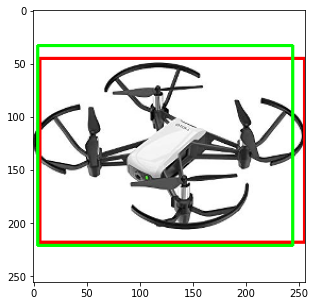

(111, 123) (115, 131)
(104, 123) (120, 138)


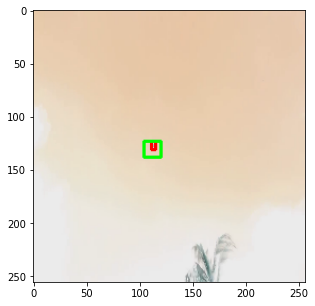

In [ ]:
plotter(y_test[4:9],X_test[4:9],ResNet101.predict(X_test[4:9]),None,None) 

* So, We have seen how **Object Localization works** and Localize the object in an image.
* **But we are not able to classify What is there in the Bounding Box**.

### How can we localize and classify the object at same time?

* In **Object Localization + Classification** we have to add 2 heads at the end of CNN as a Output.
* **Classification head** which classify the object and **Regression head** which find the **co-ordinates of Bounding Boxes**.


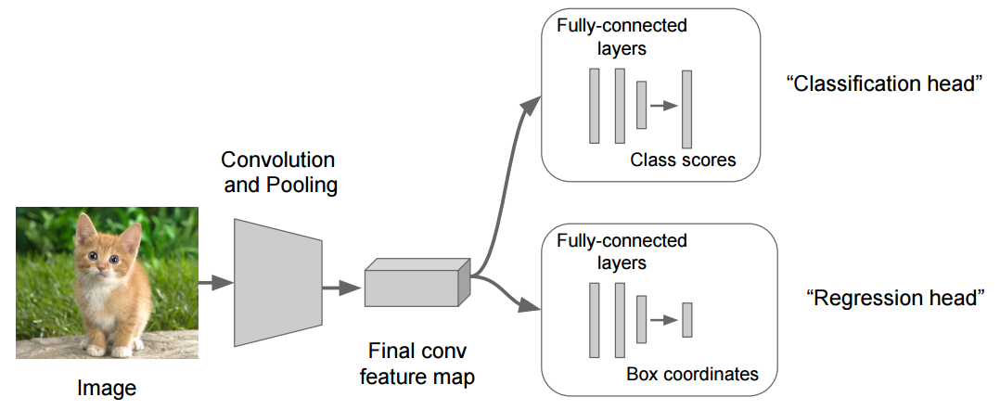

### What is the Loss function in Classification + Localization?

* In **classification + Localization** we have `final Loss` as a sum of **Softmax Loss(for classification)** + **L2 Loss(for Regression)**.

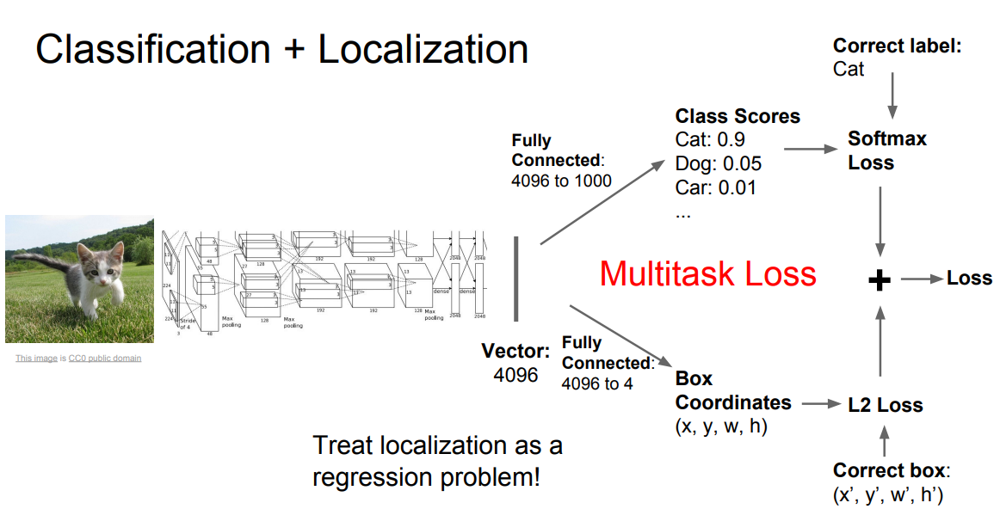

Let's look at an another example of Object Localization + Classification

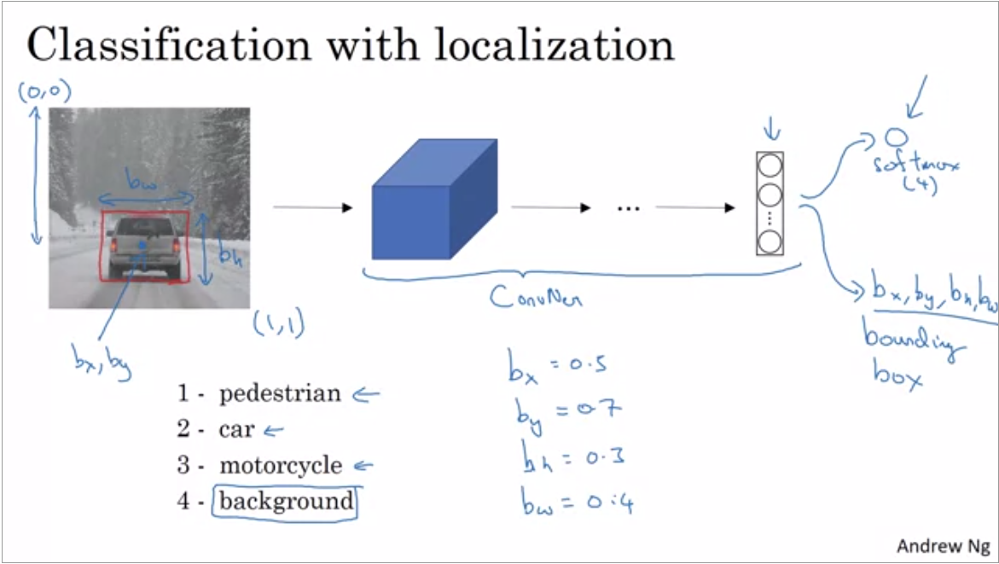

* In this example we are trying to **Locate the Object** and **classify the image into 4 categories**.
* **4th Category background** signify that `there is no Object present in the image`.

**Let's see the combined  output of Localization + Classification.**

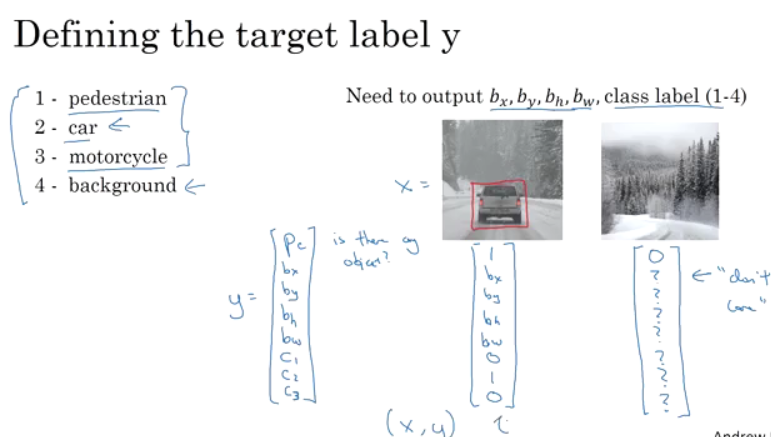

* **Target Label** of **network** output **8D array** in this example.
* **pc:** is object is present or not in the image**(Background class)**.
* **bx,by,bh,bw** represents **bounding box Co-ordinates**.
* **c1,c2,c3** represent 3 classes.
* if pc=0 then no need to calculate Bounding box.

In [ ]:
def drone_classification_data(Y):
  labels = [Y[i][0] for i in range(len(Y)) ]
  return np.array(labels)

In [ ]:
y_cat = drone_classification_data(Y)

In [ ]:
OneHot = tf.keras.utils.to_categorical(y_cat)
print('Dimension of Y:',OneHot.shape)
print('One Hot Vector:',OneHot[0])

Dimension of Y: (1459, 2)
One Hot Vector: [1. 0.]


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_single,OneHot, test_size=0.33, random_state=42)

In [ ]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((977, 256, 256, 3), (482, 256, 256, 3), (977, 2), (482, 2))

Now, Let's train a model on **Object Localization + Classification**.

In [ ]:
# Converting label to one hot vector
OneHot = tf.keras.utils.to_categorical(y_cat)
print('Dimension of Y:',OneHot.shape)
print('One Hot Vector:',OneHot[0])
X_train, X_test, trainlabel, testlabel,trainbbx,testbbx = train_test_split(X_single,OneHot,y_single, test_size=0.33, random_state=42)

Dimension of Y: (1459, 2)
One Hot Vector: [1. 0.]


### Model ResNet101 classification + Localization

You have seen how Transfer learning works for classification.<br>
 Let’s see how it works for Object Localization + Classification.

**Recipe for classification + Localization [Transfer learning]**
1. Train( or download) a class model (VGG, Resnet,......etc)
2. Attach new FC **“Regression head”** + **"Classification head"** to the network.
3. Train the **Regression head** and **Classification head** with **optimum Loss Function**.
4. At test time use both heads.


In [ ]:
resnet = tf.keras.applications.ResNet101(weights='imagenet',include_top=False,
                            input_tensor=tf.keras.layers.Input(shape=(256,256,3)))

resnet.trainable = False

x1 = resnet.output
flat = tf.keras.layers.Flatten()(x1)

# Classification head 
x1 = tf.keras.layers.Dense(128,activation='relu')(flat)
x1 = tf.keras.layers.Dense(64,activation='relu')(x1)
x1 = tf.keras.layers.Dense(32,activation='relu')(x1)

clas_out = tf.keras.layers.Dense(2,activation='softmax',name='class_output')(x1)

# Regression head
x1 = tf.keras.layers.Dense(128,activation='relu')(flat)
x1 = tf.keras.layers.Dense(64,activation='relu')(x1)
x1 = tf.keras.layers.Dense(32,activation='relu')(x1)
# output 4 B.B Co-ordinates
reg_out = tf.keras.layers.Dense(4,activation='sigmoid',name='box_output')(x1)

ResNet101_final = tf.keras.models.Model(resnet.input,[reg_out,clas_out])

In [ ]:
# ResNet101_final.summary()

In [ ]:
losses = {"box_output":"mean_squared_error",      # loss for Classification + Regression
          "class_output":"binary_crossentropy"}
loss_weights = {"box_output":4.0,                  # loss weight
          "class_output":1.0}
          
metrics = {"box_output":"mse",                    # metrics for both head
          "class_output":"accuracy"}

opt = tf.keras.optimizers.Adam(learning_rate=1e-4)                  # Optimizer
# Compile model

ResNet101_final.compile(optimizer=opt,loss=losses,loss_weights=loss_weights,metrics=metrics)

In [ ]:
from gc import callbacks

In [ ]:
# log_dir_OL_cl = "/content/gdrive/MyDrive/DSML_Course_Curriculum/Lec-Object_Localization_and_detection/drone_object_detection/logs_files/Object_loc_and_class" 
# !rm -rf log_dir_OL_cl
# tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir_OL_cl)

# history = ResNet101_final.fit(X_train,{"box_output":trainbbx,
#           "class_output":trainlabel},validation_data=(X_test,{"box_output":testbbx,
#           "class_output":testlabel}),batch_size=32,epochs=15,callbacks=(tensorboard_callback)) 

In [ ]:
# ResNet101_final.save("/content/gdrive/MyDrive/DSML_Course_Curriculum/Lec-Object_Localization_and_detection/drone_object_detection/ResNet101_final_bb_and_class")

In [ ]:
ResNet101_final=tf.keras.models.load_model("/content/gdrive/MyDrive/DSML_Course_Curriculum/Lec-Object_Localization_and_detection/drone_object_detection/ResNet101_final_bb_and_class")

In [ ]:
log_folder = '/content/gdrive/MyDrive/DSML_Course_Curriculum/Lec-Object_Localization_and_detection/drone_object_detection/logs_files/Object_loc_and_class'
%reload_ext  tensorboard
%tensorboard --logdir={log_folder}

Reusing TensorBoard on port 6006 (pid 7601), started 1:20:32 ago. (Use '!kill 7601' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
predictions,conf = ResNet101_final.predict(X_test)
miou = mean_intersection_over_union(testbbx,predictions)
print('Mean Intersection Over Union for ResNet:',miou)

Mean Intersection Over Union for ResNet: 0.5972403615229576


(28, 100) (256, 251)
(34, 24) (227, 228)


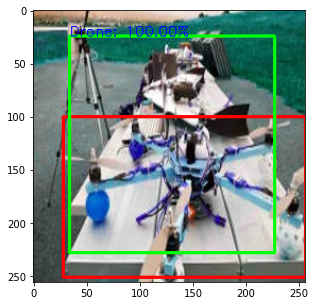

(39, 17) (222, 220)
(64, 28) (202, 221)


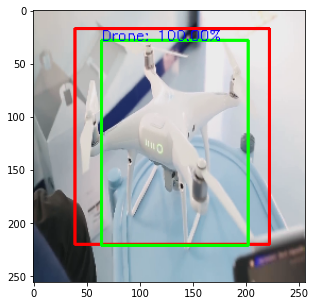

(1, 31) (247, 238)
(19, 9) (242, 212)


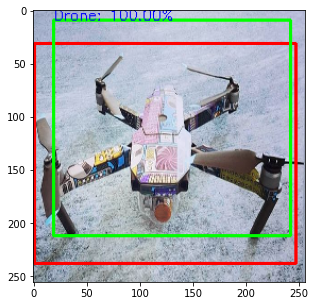

(25, 51) (244, 206)
(9, 63) (240, 183)


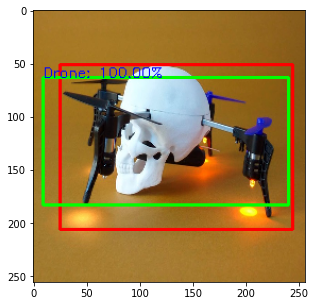

(29, 62) (219, 191)
(17, 68) (235, 218)


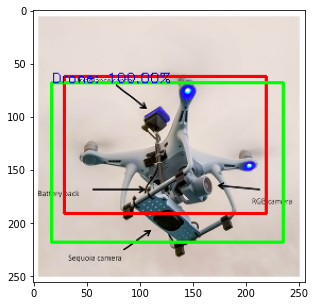

(24, 60) (229, 153)
(25, 90) (238, 172)


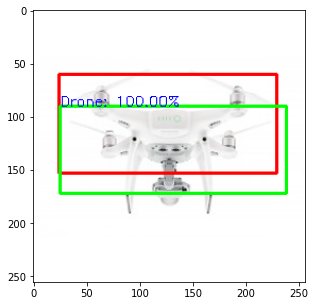

(25, 123) (244, 211)
(57, 68) (208, 185)


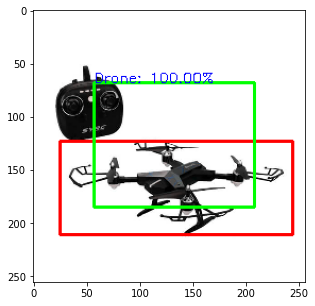

(0, 0) (0, 0)
(0, 0) (0, 0)


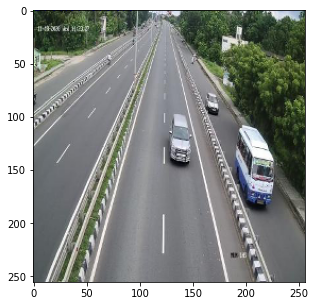

In [ ]:
preds,conf = ResNet101_final.predict(X_test[100:108])
plotter(testbbx[100:108],X_test[100:108],preds,conf,"classification") 

* So, we have built the **Object Localization + Classification model**.
* Now, we are not only able to **localize the Object** but we can also also **classify what is there in the object**.

## What if we have More then 1 object present in the image?

* Now you know the **Architecture of Object Localization**.
* It's output is fixed that is **4 output co-ordinates** that means **only 1 Bounding box**.
* So, in **Object Localization** we can only **Localize a single Object Present in the image**.

## How can we find Multiple Objects in the image?

**Object Detection** is the Algorithm in which we can **classify and locate Multiple Objects** and **draw Bounding Box around them**.

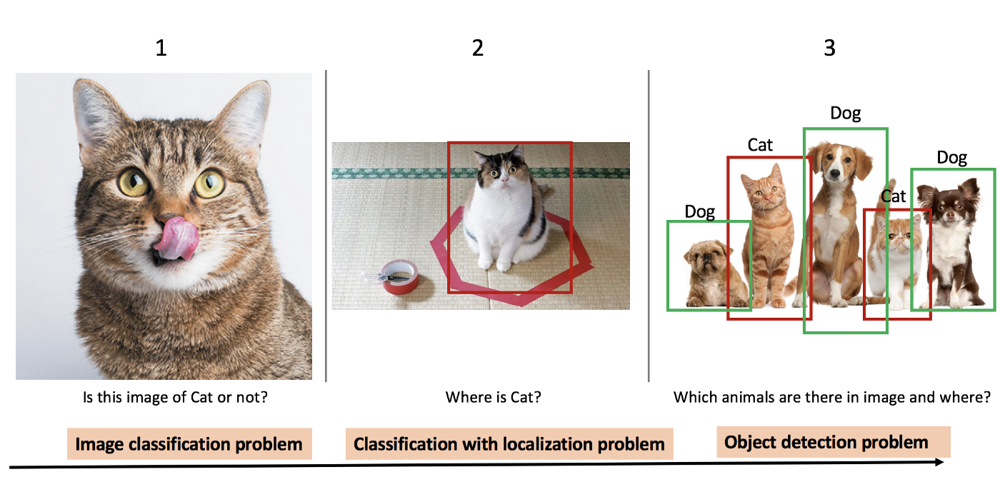

* The above image shows you the difference between **Classification**, **Localization** & **Object Detection**.

* Since in **Object Detection** we have **multiple  or Variable objects**  **present in the image**.
* If we treat **Object detection as a Regression Problem**.
* Then, for **Variable Objects** , **Variable output must be there**.
* As you can see in below image different image has different number of Bounding Box Output.

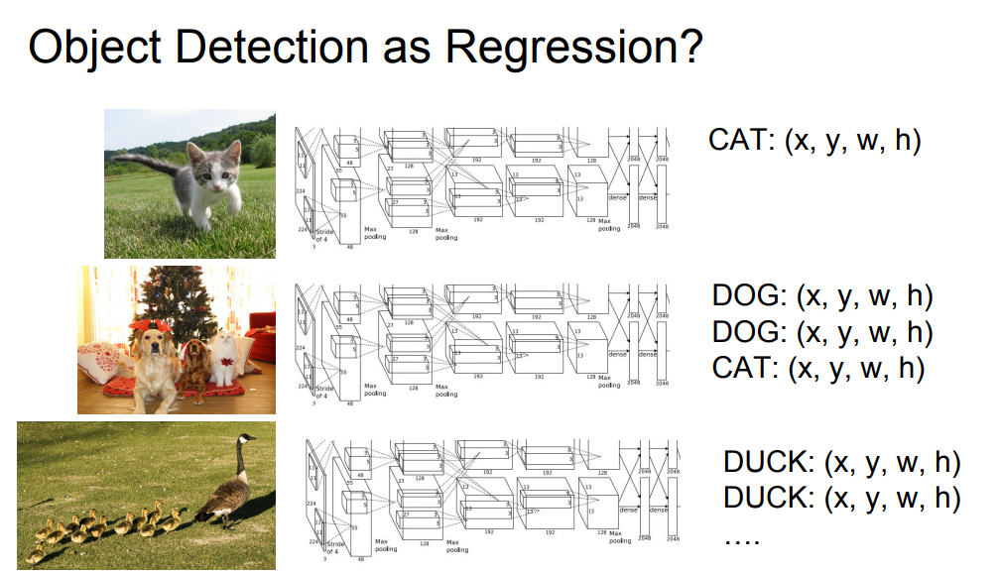

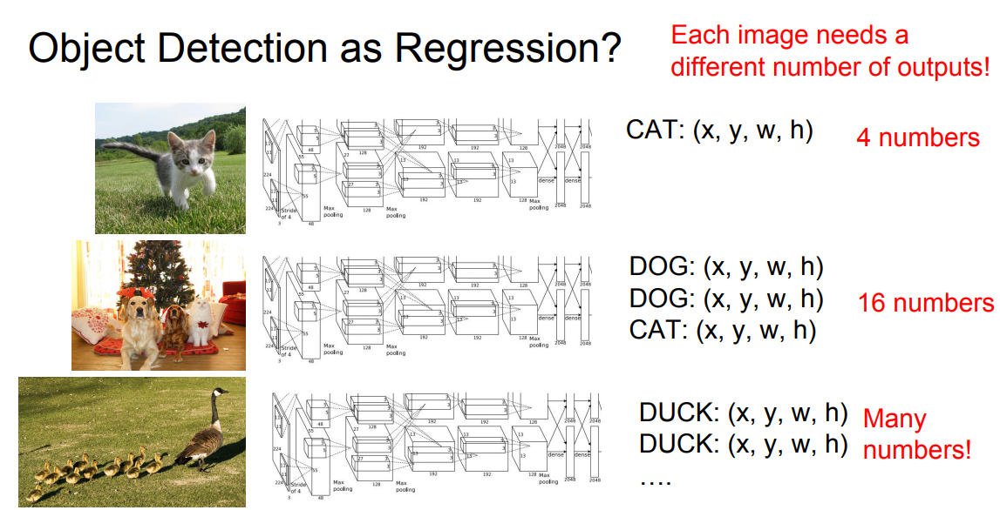

* So, it's kind of difficult to treat **Detection as a Regression Problem** because of **variable sized output**.

### How do we take care of Variable Size output?
* Take it as a **classification problem** instead of a **Regression Problem**.


Let's take a look how we can **perform Object Detection** as a **classification problem**.

Let's say you want to build a **car detection algorithm**.

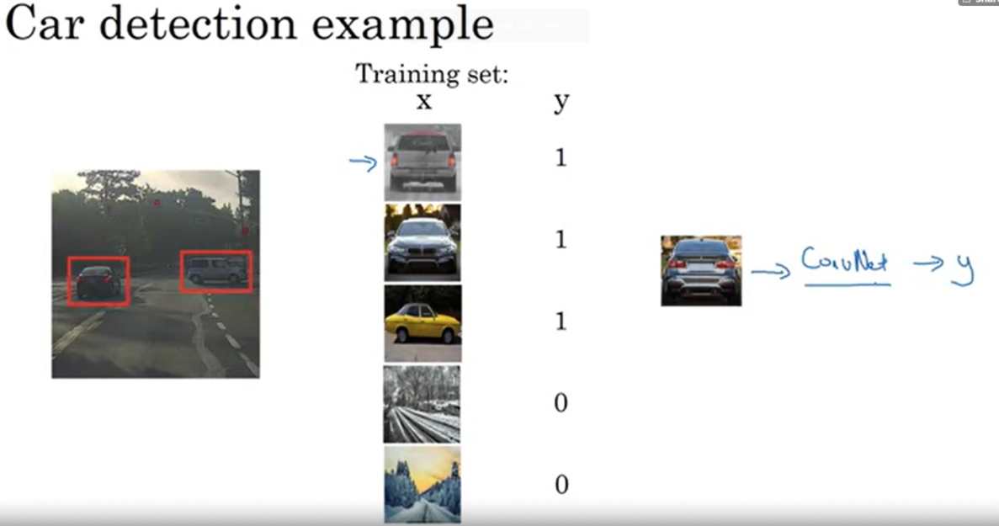

Here's are the steps to be followed.
1. First create a **label training set**, so **x and y with closely cropped examples of cars**.
2. Take the **closely cropped images of car**. 
3. Meaning that x is pretty much only the car. **So, you can take a picture and crop out and just cut out anything else that's not part of a car.**
4. So you end up with the **car centered in pretty much the entire image** [as shown in small images]. 
5. Given this label training set, you can then **train a convNET that inputs an image**, like one of these closely cropped images.
4. And then the **job of the convNET is to output y, zero or one**, is there a car or not.
5. Once you've trained up this convNET, you can then use it in **Sliding Windows Detection**.

 ## What is Sliding Window Detection?

**Sliding windows**: **“Slide”** a box around image and `classify each image crop` inside a box **(contains object or not?)**.

* **Classifying each image crop** into **car or not car** make **Object Detection** as a `classification problem`.

* Below Image shows how **Sliding Window** of **Particular size** `move across the image and Predict the car at particular location.`

In [ ]:
from IPython.display import Image
Image(url='https://miro.medium.com/proxy/1*wbuckxPMCs4BEemAuqd94g.gif')

The **basic idea** is to basically go through every region of the **particular size**, and **pass lots of little cropped images into the convNET** and have it **classified zero or one** for each position at some stride.

### What must be the size of Sliding Window?

* Since there is a possibility of different sizes objects present in the Image.
* We have to take Sliding window of **different sizes and scale**.
* And test all sliding window on the image.

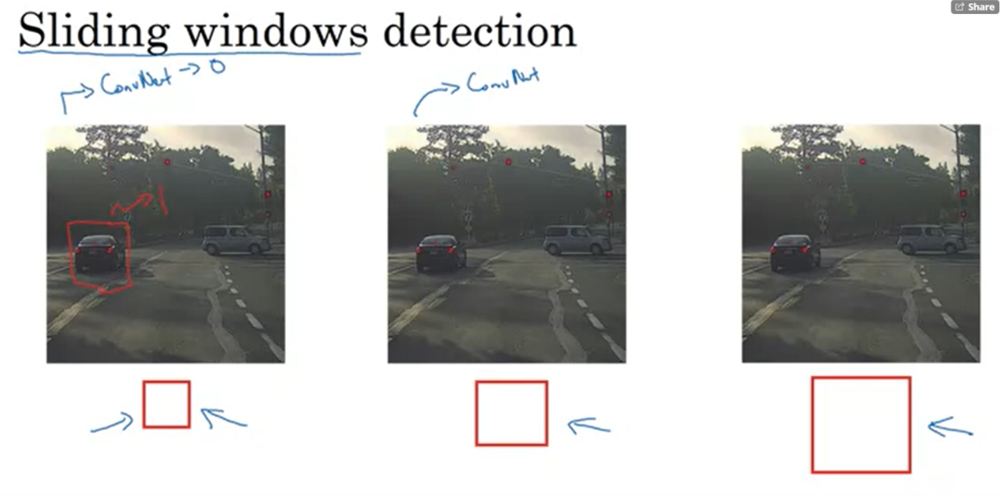

**Don't you think trying all set of Sliding window  is Computaionally Expensive.**

### Disadvantage of Sliding Window Detection

*  A huge **disadvantage of Sliding Windows** Detection is the **computational cost**.
* Because you're cropping out so many different square regions in the image and running each of them independently through a convNET.


**Trade off between Computational Cost and Performance**

* If you use  a very **big stride**, then that will reduce the number of windows you need to pass through the convNET, **but that may hurt performance**. 
* Whereas if you use a **very small stride**, then the huge number of all these little regions you're passing through the convNET means that  there is a very **high computational cost**.

* Before the rise of Neural Networks people use much simpler classifiers **like a simple linear classifier** over hand engineer features **in order to perform object detection**.
* And **Linear classifier was relatively cheap to compute**, it was just a linear function, **Sliding Windows Detection ran okay**.
* It was not a bad method, **but with convNET now running a single classification task is much more expensive** and sliding windows this way is **infeasibily slow**.
* And unless you use a `very fine granularity or a very small stride`, you end up not able to localize the objects that accurately within the image as well.

* Fortunately, however, this problem of computational cost has a pretty good solution.
* It can be handled by the **convolutional implementation of the sliding window algorithm**.

### Convolutional Implementation of Sliding Windows

* In **Sliding window approach** we take a **window on the test image** and Run the window across all image.
* Then, Each Window is passed through **CNN to classify if there is object present in image.**
* Let' see an example of test image of `16 *16 * 3` image.

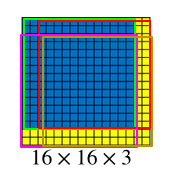

We take 4 Sliding window on this test image of size 14 * 14 * 3 and each window is passed into below CNN to clasify the image.

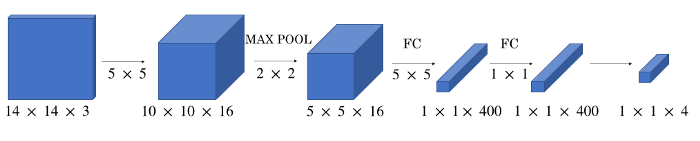

**How Convolutional implementation of above CNN network will reduce Computational Cost?**

**Ans:** `By Turning Fully Connected layer into Convolutional layers.`

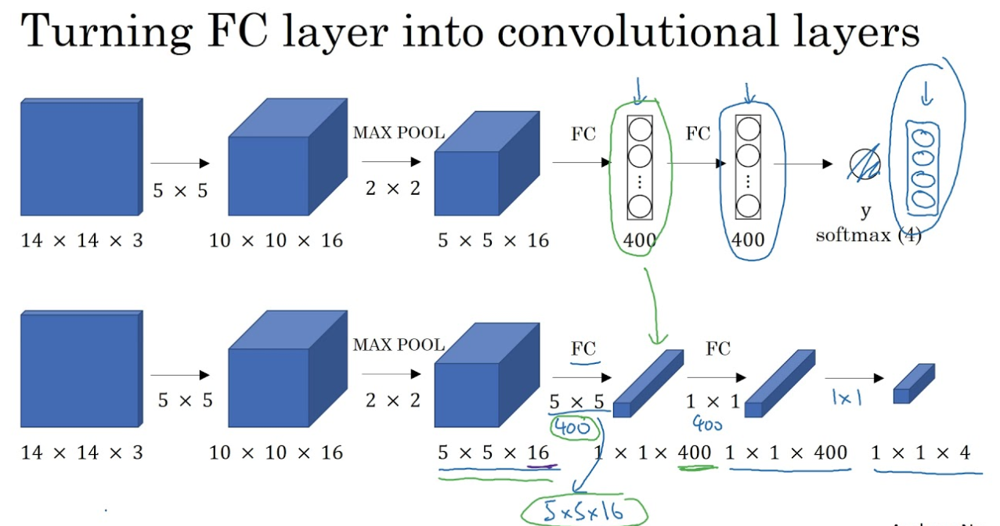

* Instead of passing 4 sliding window into convNET.
* We did a convolution implementaion of these four sliding window **which do parallel computation (share a lot of pixel values)** to find at the end a 2*2 matrix for all four sliding window.



* To run sliding windows on this `16 * 16 * 3` image is pretty small image.
*  You run this convnet four times in order to get four labels. 
* But it turns out **a lot of this computation done by these four convnets is highly duplicative**. 
* So what the convolutional implementation of sliding windows does is **it allows these four window in the convnet to share a lot of computation**.

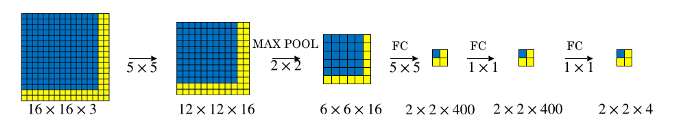

* We apply convolutional techniques to the whole image and output a 2x2x4 image.
* Each 1x1x4 in the output corresponds to one of the sliding windows as shown in different colors above.



Now, **this algorithm still has one weakness**, `the position of the bounding boxes is not too accurate`.

**Inaccurate bounding boxes**:
* We are sliding windows of square shape all over the image, maybe the **object is rectangular** or **maybe none of the squares match perfectly with the actual size of the object**.
*  Although this algorithm has ability to find and localize multiple objects in an image, **but the accuracy of bounding box is still bad**.
* Let's see some examples of inaccurate Bounding boxes.

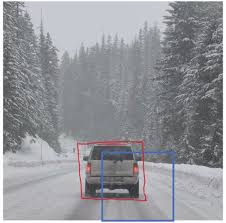

In [ ]:
from IPython.display import Image
Image(url='https://miro.medium.com/proxy/1*wbuckxPMCs4BEemAuqd94g.gif')

* In the above image More accurate Bounding Box is rectangle.

----

* Now, You know how **IoU** is used as a Evaluation metric in **Object Localization + Classification.**

### But  what could be the Evaluation Metric for Object Detection when we have Multiple objects in image?

**mAP(Mean Average Precision)** is the Evaluation Metric used to Evaluate **Object Detection model**.

* In the context of machine learning, precision typically refers to accuracy—**but in the context of object detection, IoU is our precision**.

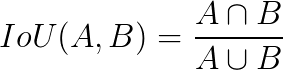

* However, we need to define a method to compute **accuracy per class and across all classes in dataset**. 
* To accomplish this goal, we need **mean Average Precision (mAP)**.
* To compute **average precision for a single class**, `we determine the IoU of all data points for a particular class`.
*  Once we have the IoU we divide by the total class labels for that specific class, yielding the average precision.
* To compute the mean average precision, we compute the **average IoU for all N classes —then we take the average of these N averages, hence the term mean average precision**.
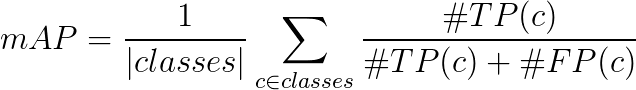

* When reading object detection papers you’ll typically see results reported in terms of mAP.
* This mAP value is derived by averaging the average precision on a per-class basis for all classes in the dataset.
* Typically we’ll report **mAP@0.5**, indicating that in order for an object in the testing set to be marked as a **“positive detection”** it must have, at least, 0.5 IoU with the ground-truth.
*  The 0.5 value is tunable, but 0.5 is fairly standard across most object detection datasets.

-----

One of the problems of **Object Detection** is that your algorithm `may find multiple detections` of the same objects.

<img src="https://cdn.analyticsvidhya.com/wp-content/uploads/2020/07/graphic4.jpg" height=300 width=600>

### How can we make sure that Object Detection algorithm detect each object only once.?

**Non-Max Suppression**

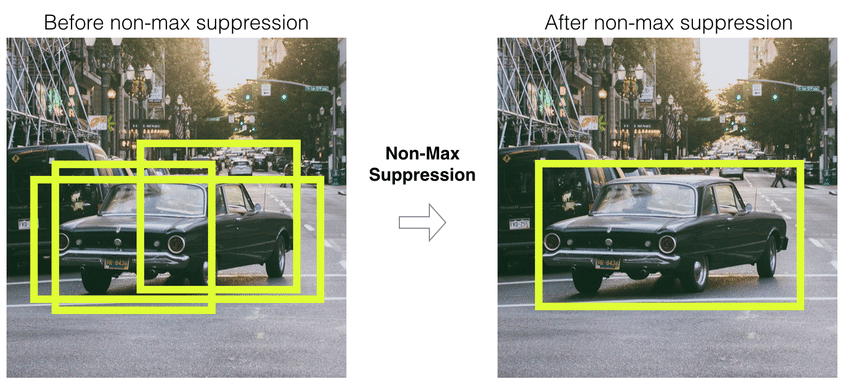

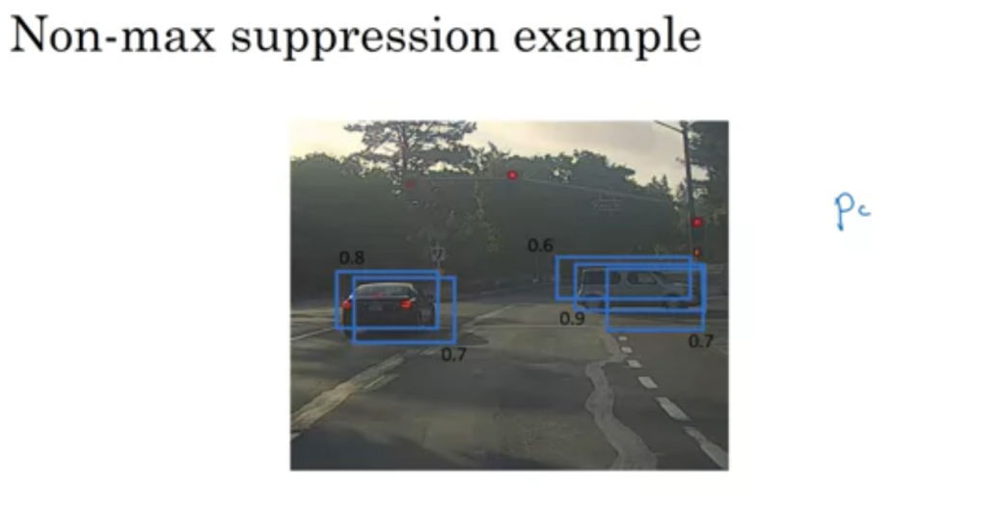


* When running sliding window across the image. 
* It may be possible that different sliding window may think that **car midpoint** is present in their cell.
* So, many different Bounding box for a particular object is possible.

* So, what non-max suppression does, is it cleans up these detections. 
* It end up with just one detection per car, rather than multiple detections per car.
* And **non-max means** that you're going to output your **maximal probabilities classifications but suppress the close-by ones that are non-maximal.**

**How the algorithm for Non-Max Supression works?**

**Input:** A list of **Proposal boxes B**, corresponding confidence scores S and overlap threshold N.

**Output:** A list of filtered proposals D.

**Algorithm**:
1. Select the **proposal with highest confidence score**, remove it from B and `add it to the final proposal list D.`.
2.Now compare this proposal with all the proposals — **calculate the IOU of this proposal with every other proposal**. 
3. If the `IOU is greater than the threshold N`, remove that proposal from B.
4. Again take the proposal with the **highest confidence from the remaining proposals** in B and remove it from B and add it to D.
5. Once again calculate the IOU of this proposal with all the proposals in B and eliminate the boxes which have high IOU than threshold.
6. This process is `repeated until there are no more proposals left in B.`

-----

One of the **problems** **with object detection** as you have seen it so far is that each of the `grid cells can detect only one object`.

## What if a grid cell wants to detect multiple objects in a single Grid Cell ?

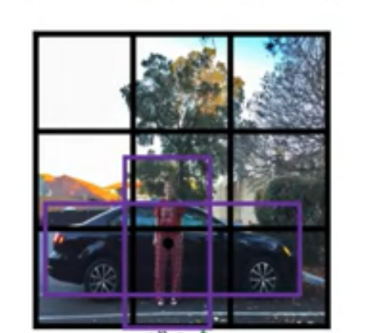

* **Anchor Boxes is the way to detect multiple objects in the same grid cell.**
* With the idea of anchor boxes, what you are going to do, is **pre-define two different shapes** called, `anchor boxes or anchor box shapes`. 
* Next step is to **associate two predictions with the two anchor boxes**. 
* And in general, `you might use more anchor boxes, maybe five or even more`.

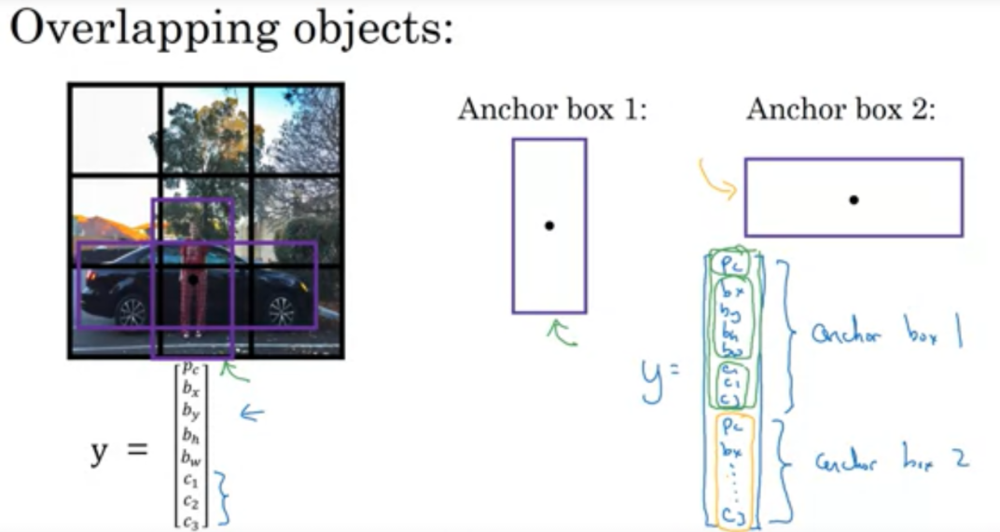

* In the above image Mid point of both `Person` and `car` lies in the same Grid Cell.
* We have already Pre-defined two bounding box for each class.
* The output will be 2 Anchor boxes.

**What object Detection algorithm does Previously?**
* `Each Object in training image is assigned to grid cell that contains that object midpoint's`.

**How Object Detection with Anchor Boxes Works?**
* `Each Object in training image is assigned to grid cell that contains that object midpoint's` **and Anchor Box for the Grid Cell with Highest IoU**

Let's look at an eaxample.

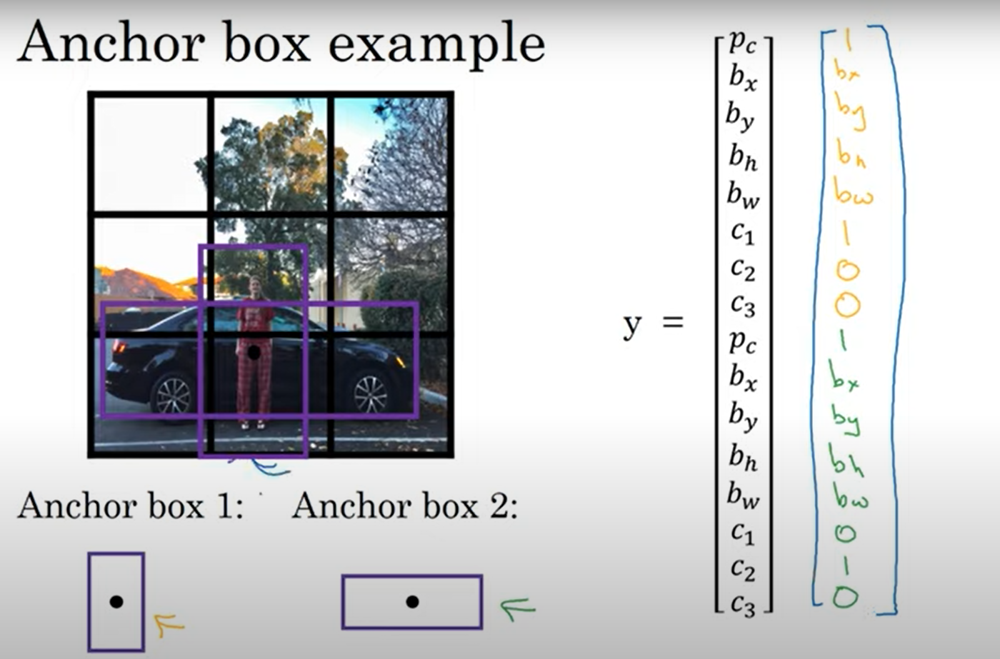

* In this example `person is more similar to shape of Anchor Box 1` and **hence have Highest IoU with Anchor Box1**. 
* And Car is more similar to shape of `Anchor Box 2` and have **Highest IoU with Anchor Box2**.
* So, in **final output y we see both Anchor Box output and their co-ordinates.**

----

* Untill now we were able to frame object detection as classification, simply by utilizing sliding windows.
* The problems with this approach is :

**In Sliding Window we have to test many positions and scales and then pass it to CNN, which is computationally very expensive.**


## What could be the solution to reduce Computation?

* `Only look at the tiny subset of possible solutions.`
*  **Tries to pick just a few regions which has any objects**.
* It proposes a region in which **objects can be present**.
* We called them as **Region Propasal Networks.**
* Rather than `sliding a window` through the picture, they **tried to group similar pixels in an image to form a** **‘region’** .
* And then only **selected Regions are passesd into CNN.**

The **First Region Proposal Network** developed is **R-CNN**.

## R-CNN

* The basic idea behind the R-CNN is to Propose some Regions from the image where ther is a chance of Object present.
* Then, those selected Regions are classified into different classes.

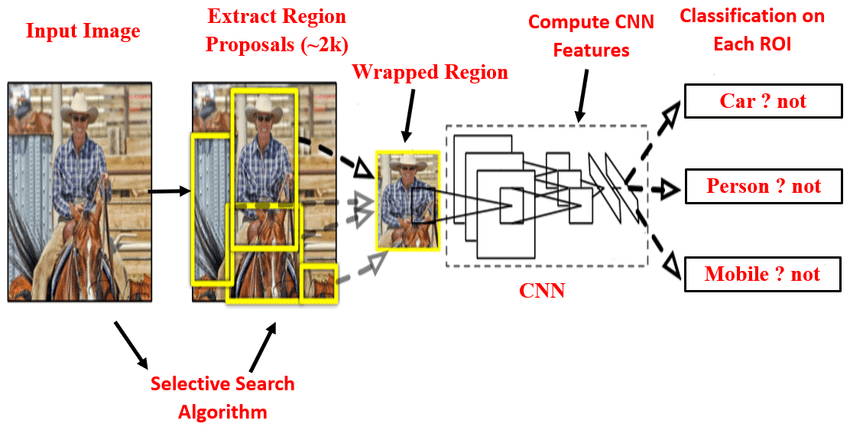

An overview of the R-CNN algorithm can
be found in above figure, which includes a four step process:
* **Step #1:** Input an image
* **Step #2:** Extract regions proposals (i.e., regions of the image that potentially contain objects)
using an algorithm such as **Selective Search**.
* **Step #3:** `Use transfer learning`, specifically **feature extraction**, **to compute features for each proposal** (`which is effectively an ROI`) using the **pre-trained CNN**.
* **Step #4:** Classify each proposal using the extracted features with a **Support Vector Machine(SVM).**

* In the first step we input an image to our algorithm. We then run a region proposal algorithm as
such **Selective Search (or equivalent)**.
* The `Selective Search algorithm takes the place of sliding windows` , intelligently examining the input image at various scales and
locations.
* Thereby dramatically reducing the total number of proposal ROIs that will be sent to the
network for classification.



Now, we have seen how R-CNN Works. But there is some problem with RCNN.

* The **problem** with the original **R-CNN approach** is that it’s still **incredibly slow**.
* And furthermore, we’re not actually learning to **localize via deep neural network**.
* Instead, we’re **leaving the localization to the Selective Search** algorithm — `we’re only classifying` the ROI once it’s been determined as “interesting” and “worth examining” by the region proposal
algorithm.

## Is it possible to obtain end-to-end deep learning-based object detection?

* Approximately after a year a new algorithm came **Fast R-CNN**.
* Similar to the original R-CNN, **Fast R-CNN algorithm still utilized Selective Search to obtain region proposals**.
* But a novel contribution was made: Region of Interest (ROI) Pooling.

## Fast R-CNN

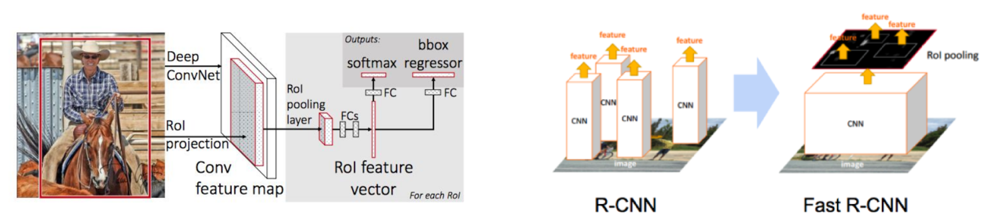

* In the **Fast R-CNN architecture**, we still use **Selective Search to obtain our proposals**,
but now we apply **ROI Pooling by extracting a fixed-size window from the feature map** and `using
these features to obtain the final class label and bounding box`.

Let's see the Fast R-CNN Architecture in detail

* In this new approach, we apply **the CNN(pre-trained)** to the entire input image and **extract a feature map**.
* **ROI Pooling works by extracting a fixed-size window from the feature map** and then passing it into a set of `fully-connected layers to obtain the output label for the ROI.`
* We’ll discuss ROI Pooling in more detail later, but for the time being, understand that **ROI Pooling operates over the feature map extracted from the CNN and extracts a fixed-size window from it.**

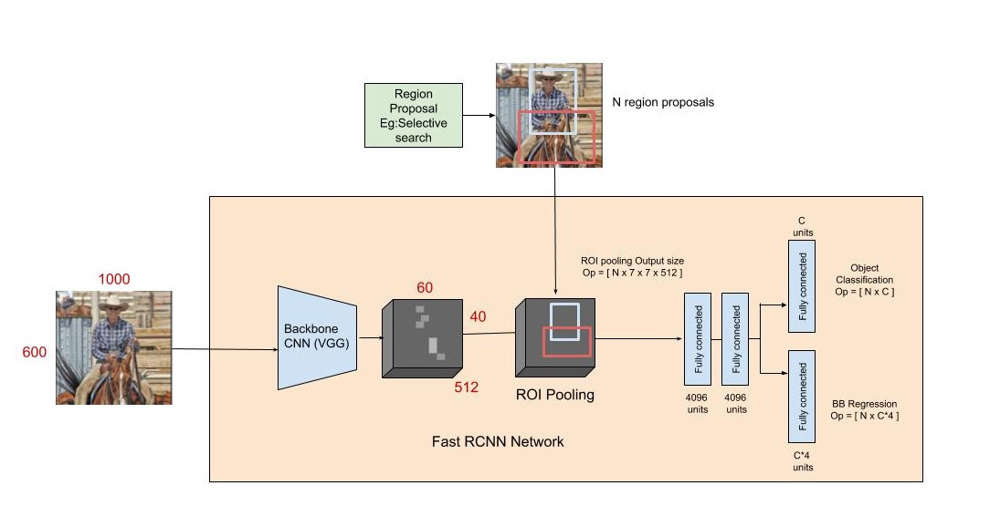

The primary benefit here is that the network is now, effectively, end-to-end trainable:
1. `We input an image and associated ground-truth bounding boxes`.
2. **Extract the feature map**
3. Apply **ROI pooling** and obtain **the ROI feature vector**.
4. And finally use two sets of fully-connected layers to obtain <br>
 (1) **the class label predictions** and <br>
 (2) the **bounding box locations** for each proposal. <br>

But to make the **R-CNN architecture even faster** we need to incorporate the **region proposal directly into the R-CNN.**

Let's see how we can do this

## Faster R-CNN

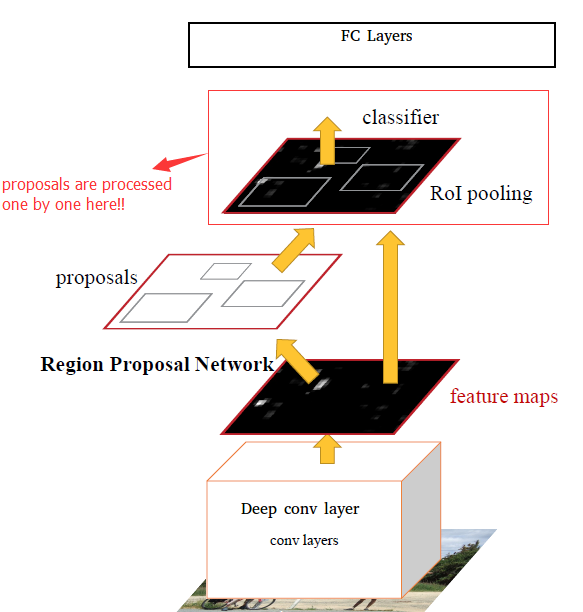

The main idea is use the **last (or deep) conv layers to infer region proposals**.
Faster-RCNN consists of two modules.
* **RPN (Region proposals):** Gives a set of rectangles based on deep convolution layer
* **Fast-RCNN Roi Pooling layer:** Classify each proposal, and refining proposal location.

#### Region proposal Network

Here we break on a block diagram how **Faster RCNN works**.
1. Get a **trained (ie imagenet) convolution neural network.**
2. Get **feature maps** from the `last (or deep) convolution layer`.
3. Train a **region proposal network** that will decide if there is an object or not on the image, and also propose a box location.
4. Give results to a custom (python) layer.
5. Give proposals to a **ROI pooling layer (like Fast RCNN).**
6. After all proposals get reshaped to a fix size, send to a **fully connected layer to continue the classification**.

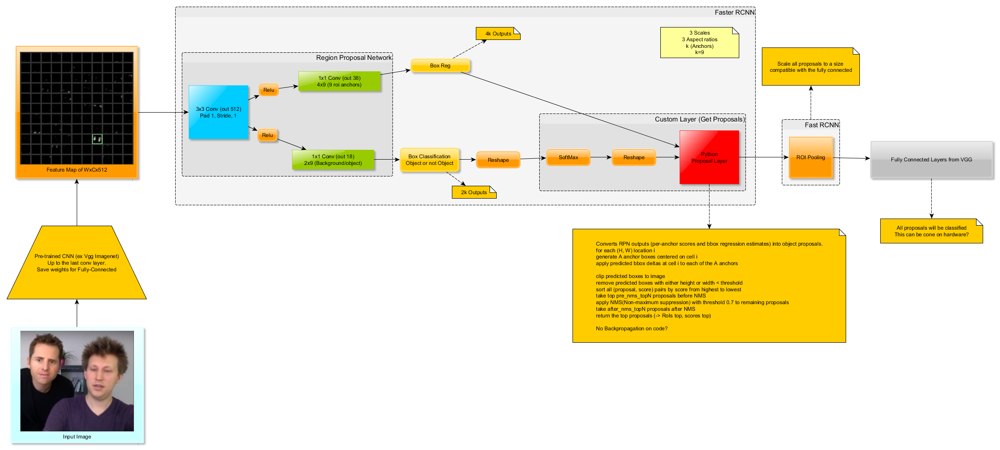

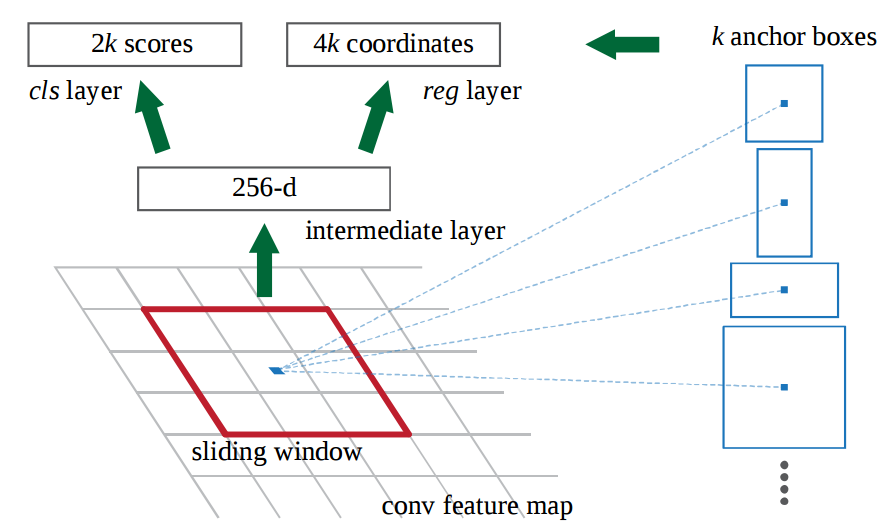

**How it works?**

Basically the RPN slides a small window (3x3) on the feature map, that classify what is under the window as object or not object, and also gives some bounding box location.
For every slidding window center it creates fixed k anchor boxes, and classify those boxes as been object or not.

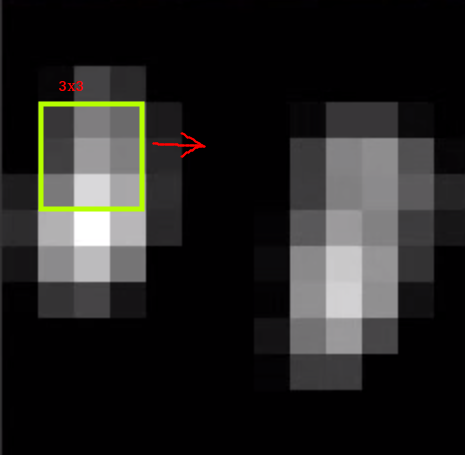

### Faster RCNN training

On the paper, each network was trained separately, but we also can train it jointly. Just consider the model having 4 losses.
* RPN Classification (Object or not object)
* RPN Bounding box proposal
* Fast RCNN Classification (Normal object classification)
* Fast RCNN Bounding-box regression (Improve previous BB proposal)

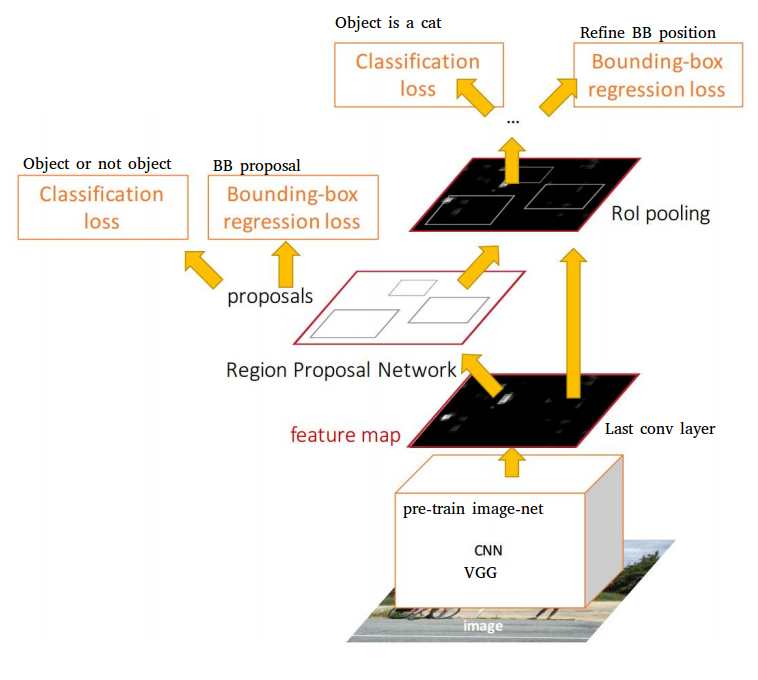

#### Faster RCNN results

The best result now is Faster RCNN with a resnet 101 layer.


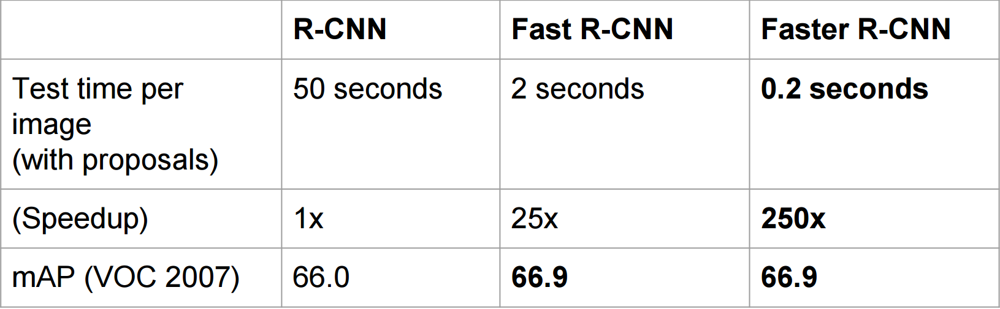

### Implementation of R-CNN

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,Y, test_size=0.33, random_state=42)

In [ ]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((977, 256, 256, 3), (482, 256, 256, 3), (977, 5), (482, 5))

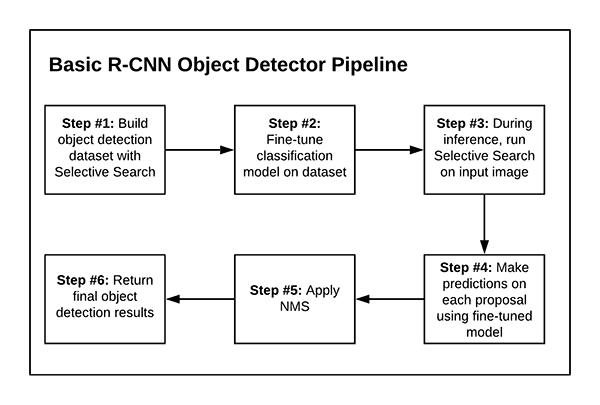

In [ ]:
def compute_iou(boxA, boxB):
	# determine the (x, y)-coordinates of the intersection rectangle
	xA = max(boxA[0], boxB[0])
	yA = max(boxA[1], boxB[1])
	xB = min(boxA[2], boxB[2])
	yB = min(boxA[3], boxB[3])

	# compute the area of intersection rectangle
	interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)

	# compute the area of both the prediction and ground-truth
	# rectangles
	boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
	boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)

	# compute the intersection over union by taking the intersection
	# area and dividing it by the sum of prediction + ground-truth
	# areas - the intersection area
	iou = interArea / float(boxAArea + boxBArea - interArea)

	# return the intersection over union value
	return iou

#### Selective Search

In [ ]:
def get_roi_and_labels():
  roi = []
  label  = []

  ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()   # Initialize Selective search

  for sample in range(len(X_train)):
    ss.setBaseImage(X_train[sample])    # Loop over the image folder and set each image one by one as the base for selective search 
    ss.switchToSelectiveSearchFast()    # Initialising fast selective search
    rects = ss.process()                # getting proposed regions using ss.process()

    proposedRects = []
    counter = 0               # counter for Drone Class label
    falsecounter = 0          # counter for Background Class label
    for (x,y,w,h) in rects:
      proposedRects.append((x,y,x+w,y+h))

    # loop over the maximum number of region proposals
    positiveROIs = 0
    gtbox = y_train[sample].copy()
    # print(gtbox[1:])
  #   classes = int(gtBoxes[0])+1
    for proposedRect in proposedRects:
        # unpack the proposed rectangle bounding box
      (propStartX, propStartY, propEndX, propEndY) = proposedRect
        # loop over the ground-truth bounding boxes
      # for gtbox in gtBoxes:
      # print(gtbox[1:])
      x1,y1,x2,y2=yolo_bbox_2_bbox(gtbox[1:])
      
      box = np.array([x1,y1,x2,y2])
      iou = compute_iou(box,proposedRect)        # Calculate IOU b/w G.T box and Propesed Regions
      # print(iou)
      temp = X_train[sample][propStartY:propEndY, propStartX:propEndX]
      temp = cv2.resize(temp,(256,256),interpolation=cv2.INTER_CUBIC)

      if counter<30 and iou> 0.7:                # If IOU b/w G.T and Proposed region > threshold ==> Label the region as Drone
        label.append(1)
        counter+=1
        roi.append(temp)
        positiveROIs +=1

      if falsecounter<30 and iou<0.3:            # If IOU b/w G.T and Proposed region < threshold ==> Label the region as Background
        label.append(0)
        falsecounter+=1
        roi.append(temp)
        positiveROIs +=1
  
  return np.array(roi),np.array(label)

In [ ]:
roi,label=get_roi_and_labels()   # get roi and labels for ROI
print(roi.shape,label.shape)

(37089, 256, 256, 3) (37089,)


In [ ]:
unique, counts = np.unique(label, return_counts=True)
dict(zip(unique, counts))


{0: 29101, 1: 7988}

In [ ]:
OneHot = tf.keras.utils.to_categorical(label)
print('Dimension of Y:',OneHot.shape)
print('One Hot Vector:',OneHot[0])

Dimension of Y: (37089, 2)
One Hot Vector: [1. 0.]


In [ ]:
X_train_roi, X_test_roi, y_train_roi, y_test_roi = train_test_split(roi,OneHot, test_size=0.33, random_state=42)

In [ ]:
ResNet101 = tf.keras.applications.ResNet101(weights='imagenet',include_top=False,
                            input_tensor=tf.keras.layers.Input(shape=(256,256,3)))

ResNet101.trainable = False

x1 = ResNet101.output
x1 = tf.keras.layers.Flatten()(x1)
x1 = tf.keras.layers.Dense(128,activation='relu')(x1)
x1 = tf.keras.layers.Dense(64,activation='relu')(x1)
x1 = tf.keras.layers.Dense(32,activation='relu')(x1)
x1 = tf.keras.layers.Dense(2,activation='softmax')(x1)


ResNet101_class = tf.keras.models.Model(ResNet101.input,x1)

171458560/171446536 [==============================] - 1s 0us/step


In [ ]:
# ResNet101_class.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5),
#               loss = 'categorical_crossentropy',metrics=['accuracy'])

# log_dir = "/content/gdrive/MyDrive/DSML_Course_Curriculum/Lec-Object_Localization_and_detection/drone_object_detection/logs_files/RCNN_logs" 
# !rm -rf log_dir
# tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir)

# history = ResNet101_class.fit(X_train_roi,y_train_roi, epochs=10, 
#                               validation_data=[X_test_roi,y_test_roi],
#                               callbacks=(tensorboard_callback))

In [ ]:
# ResNet101_class.save("/content/gdrive/MyDrive/DSML_Course_Curriculum/Lec-Object_Localization_and_detection/drone_object_detection/ResNet101_class")

In [ ]:
ResNet101_class = tf.keras.models.load_model('/content/gdrive/MyDrive/DSML_Course_Curriculum/Lec-Object_Localization_and_detection/drone_object_detection/ResNet101_class')

# Check its architecture
# ResNet101_class.summary()

In [ ]:
log_folder = '/content/gdrive/MyDrive/DSML_Course_Curriculum/Lec-Object_Localization_and_detection/drone_object_detection/logs_files/RCNN_logs'
%reload_ext  tensorboard
%tensorboard --logdir={log_folder}

<IPython.core.display.Javascript object>

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
def ConfusionMatrix(x,y,model):
  raw_predictions = model.predict(x)
  class_predictions = np.argmax(raw_predictions, axis=1)
  ground_truth = np.argmax(y, axis=1)
  cm = confusion_matrix(ground_truth,class_predictions) # last batch 
  label_list = ['BackGround',"Drone"]

  sns.heatmap(cm, annot=True, xticklabels=label_list, yticklabels=label_list, cmap="YlGnBu", fmt='g')
  plt.show()

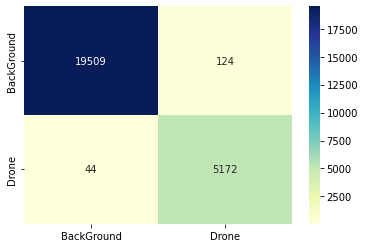

In [ ]:
ConfusionMatrix(X_train_roi,y_train_roi,ResNet101_class)

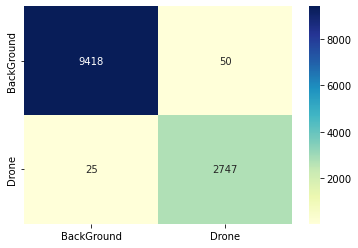

In [ ]:
ConfusionMatrix(X_test_roi,y_test_roi,ResNet101_class)

#### Inference

In [ ]:
# y_test[13].shape

(5,)

In [ ]:
# # Images which contain multiple objects
# for i in range(len(y_test)):
#   if y_test[i].shape[0]>1:
#     print(f'index={i} shape={y_test[i].shape}')

In [ ]:
def inference_on_test_image(sample_img,Bbox):
  roi_proposals = []
  boxes = []

  ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()

  ss.setBaseImage(sample_img)
  ss.switchToSelectiveSearchFast()
  rects = ss.process()
  proposedRects = []
  counter = 0

  for (x,y,w,h) in rects:
      proposedRects.append((x,y,x+w,y+h))

  gtbox = Bbox
  # loop over the maximum number of region proposals
  for proposedRect in proposedRects:
        # unpack the proposed rectangle bounding box
      (propStartX, propStartY, propEndX, propEndY) = proposedRect
        # loop over the ground-truth bounding boxes
      # for gtbox in gtBoxes:
      x1,y1,x2,y2=yolo_bbox_2_bbox(gtbox[1:])
      box = np.array([x1,y1,x2,y2])

      iou = compute_iou(box,proposedRect)
      # print(iou)
      if counter<30:
        if iou > 0.7 :
          temp = X_test[10][propStartY:propEndY, propStartX:propEndX]
          boxes.append([propStartX,propStartY,propEndX,propEndY])
          temp = cv2.resize(temp,(256,256),interpolation=cv2.INTER_CUBIC)
          roi_proposals.append(temp)
          counter+=1
  return np.array(roi_proposals,dtype='float32'),np.array(boxes,dtype='int32')



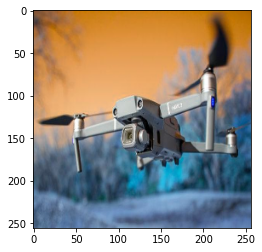

In [ ]:
sample_image = X_test[13]   # sample image
sample_b_box=y_test[13]
plt.imshow(sample_image)
plt.show()


In [ ]:
proposals ,boxes = inference_on_test_image(sample_image,sample_b_box)
proposals.shape,boxes.shape

((8, 256, 256, 3), (8, 4))

In [ ]:
proba = ResNet101_class.predict(proposals)
# print(proba)
idxs = np.where(np.argmax(proba,axis=1)==0)[0]
# print(idxs)

boxes = boxes[idxs]
proba = proba[idxs][:,1]

In [ ]:
boxes.shape, proba.shape

((8, 4), (8,))

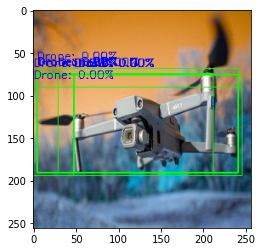

In [ ]:
clone = sample_image.copy()
# loop over the bounding boxes and associated probabilities
for (box, prob) in zip(boxes, proba):
	# draw the bounding box, label, and probability on the image
	(startX, startY, endX, endY) = box
	cv2.rectangle(clone, (startX, startY), (endX, endY),(0, 255, 0), 1)
	y = startY - 10 if startY - 10 > 10 else startY + 10
	text= "Drone: {:.2f}%".format(prob * 100)
	cv2.putText(clone, text, (startX, y),
		cv2.FONT_HERSHEY_SIMPLEX, 0.45, (0, 0, 255), 1)
# show the output *before* running NMS
plt.imshow(clone)

#### Non Max Suppression

In [ ]:
from imutils.object_detection import non_max_suppression
import imutils

In [ ]:
temp1=non_max_suppression(boxes,proba)

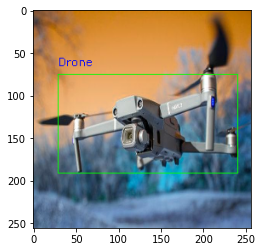

In [ ]:
clone = sample_image.copy()
# loop over the bounding boxes and associated probabilities

# draw the bounding box, label, and probability on the image
for box in temp1:
	(startX, startY, endX, endY) = box
	cv2.rectangle(clone, (startX, startY), (endX, endY),(0, 255, 0), 1)
	y = startY - 10 if startY - 10 > 10 else startY + 10
	text= "Drone"
	cv2.putText(clone, text, (startX, y),cv2.FONT_HERSHEY_SIMPLEX, 0.45, (0, 0, 255), 1)
	# show the output after *before* running NMS
	plt.imshow(clone)